<a href="https://colab.research.google.com/github/jrod-projects-hub/Portfolio-Projects/blob/main/Bana_4308_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install keras tensorflow matplotlib
!pip install ann_visualizer
!pip install grahpviz

  Preparing metadata (setup.py) ... done
  Created wheel for ann_visualizer: filename=ann_visualizer-2.5-py3-none-any.whl size=4169 sha256=07bf8ee6f53269e3d7056bb4e2e987bc37f8a1ac31b80432ff8fc097e12ef96f
  Stored in directory: /root/.cache/pip/wheels/6e/0f/ae/f5dba91db71b1b32bf03d0ad18c32e86126093aba5ec6b6488
Successfully built ann_visualizer
ERROR: Could not find a version that satisfies the requirement grahpviz (from versions: none)
ERROR: No matching distribution found for grahpviz


In [ ]:
# Bana 4308 Loan prediction Project
# Jaime Rodriguez

from google.colab import drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


## application_train EDA

In [ ]:
#establish connection with collab file to google drive
try:
  drive.mount('/content/drive', force_remount = True)
  #drive.mount('https://docs.google.com/spreadsheets/d/1KfIhC2U-wR2NqdqQxZdNReK1U3jqQmo0/edit?usp=drive_link&ouid=111353866005068477744&rtpof=true&sd=true')
  print('drive mounted successfully')
except:
  print('error mounting drive')


Mounted at /content/drive
drive mounted successfully


In [ ]:
#assign memory slots to data file
#took about 7 mins
application_train = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/Bana 4308 Project Data/application_train.xlsx')
bureau = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bana 4308 Project Data/bureau.csv')
bureau_balance = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bana 4308 Project Data/bureau_balance.csv')
previous_application = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bana 4308 Project Data/previous_application.csv')
pos_cash_balance = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bana 4308 Project Data/POS_CASH_balance.csv')
credit_card_balance = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Bana 4308 Project Data/credit_card_balance.csv')


## Application_train data set info
- 122 fields
-count, mean, std, min, quartile values(.25,.5,.75, max)
-dtypes

so far what has been done
- imputation with mean (for numerical cols) and imputation w/ mode (for categorical columns)

- no normalization since this can depend on the algorithm chosen mostly

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [ ]:
application_train.describe()

In [ ]:
#determines num of missing values per column
num_missing= application_train.isnull().sum()
print(num_missing)

In [ ]:
# for now we will impute (for missing values) numerical columns with the mean and categorical with the mode for a simple start
for column in application_train.columns:
  if application_train[column].dtype == 'object':
    application_train[column].fillna(application_train[column].mode()[0], inplace=True)
for column in application_train.columns:
  if application_train[column].dtype != 'object':
    application_train[column].fillna(application_train[column].mean(), inplace=True)

In [ ]:
#checks to see if there are still null values
num_missing= application_train.isnull().sum()
print(num_missing)
#all nulls have been successfully imputed

In [ ]:
# seperates categorical and numerical cols into seperate lists for analysis to be eaiser
categorical_cols= []
numerical_cols= []
excluded_cols= ['TARGET', 'SK_ID_CURR']
for col in application_train.columns:
  if application_train[col].dtype == 'object':
    categorical_cols.append(col)
  else:
    numerical_cols.append(col)

numerical_cols= [x for x in numerical_cols if x not in excluded_cols]
categorical_cols= [x for x in categorical_cols if x not in excluded_cols]

In [ ]:
#tells me what are the unique values in each column
for column in application_train.columns:
  print(column)
  print(f"DATA TYPE: {application_train[column].dtype}")
  print(application_train[column].unique())
  print('\n')

SK_ID_CURR
DATA TYPE: int64
[100002 100003 100004 ... 456253 456254 456255]


TARGET
DATA TYPE: int64
[1 0]


NAME_CONTRACT_TYPE
DATA TYPE: object
['Cash loans' 'Revolving loans']


CODE_GENDER
DATA TYPE: object
['M' 'F' 'XNA']


FLAG_OWN_CAR
DATA TYPE: object
['N' 'Y']


FLAG_OWN_REALTY
DATA TYPE: object
['Y' 'N']


CNT_CHILDREN
DATA TYPE: int64
[ 0  1  2  3  4  7  5  6  8  9 11 12 10 19 14]


AMT_INCOME_TOTAL
DATA TYPE: float64
[202500.  270000.   67500.  ...  96768.  546250.5 113062.5]


AMT_CREDIT
DATA TYPE: float64
[ 406597.5 1293502.5  135000.  ...  181989.   743863.5 1391130. ]


AMT_ANNUITY
DATA TYPE: float64
[24700.5 35698.5  6750.  ... 71986.5 58770.  77809.5]


AMT_GOODS_PRICE
DATA TYPE: float64
[ 351000.  1129500.   135000.  ...  453465.   143977.5  743863.5]


NAME_TYPE_SUITE
DATA TYPE: object
['Unaccompanied' 'Family' 'Spouse, partner' 'Children' 'Other_A' 'Other_B'
 'Group of people']


NAME_INCOME_TYPE
DATA TYPE: object
['Working' 'State servant' 'Commercial associate' 

In [ ]:
for value in application_train['NAME_CONTRACT_TYPE'].unique():
  plt.figure() # Create a new figure for each category
  sns.boxplot(data=application_train[application_train['NAME_CONTRACT_TYPE'] == value], x='CNT_CHILDREN')
  plt.title(f'Box Plot of CNT_CHILDREN for NAME_CONTRACT_TYPE = {value}')
  plt.show()

In [ ]:
#create box plots for each numerical column
for column in numerical_cols:
  plt.figure() # Create a new figure for each column
  sns.boxplot(data=application_train, x=column)
  plt.title(f'Box Plot of {column}')
  plt.show()

## visualizing numerical variable's distributions to determine Outliers

target and id variables are excluded

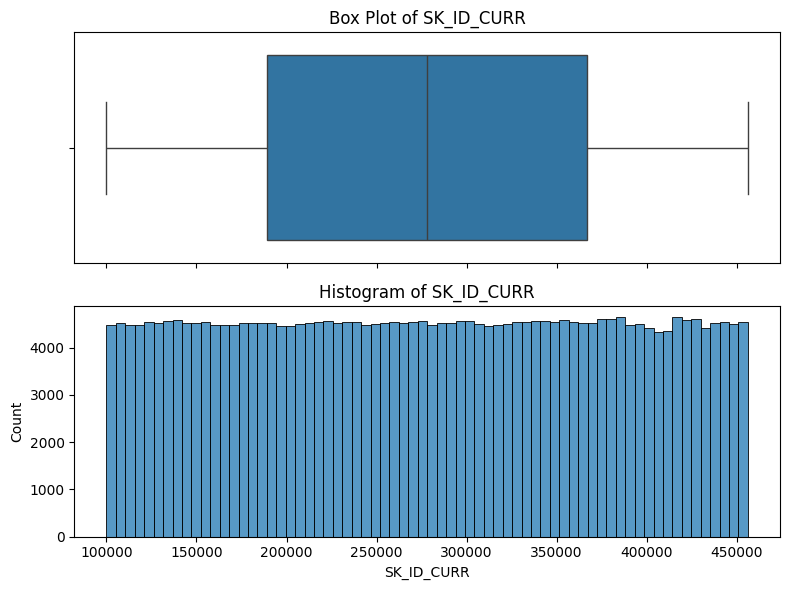

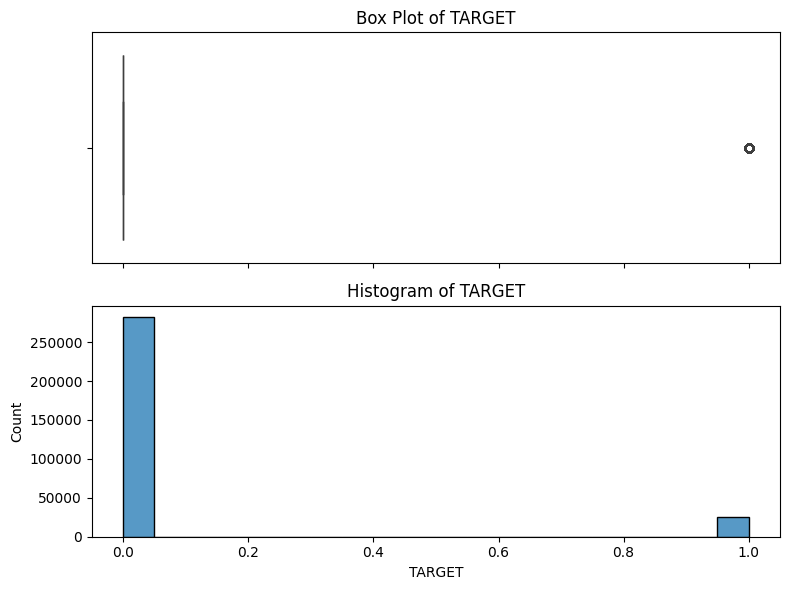

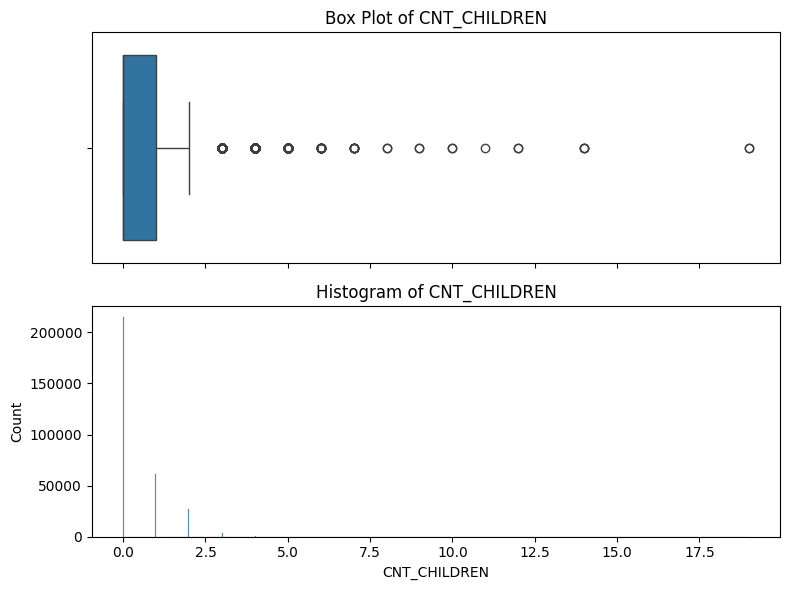

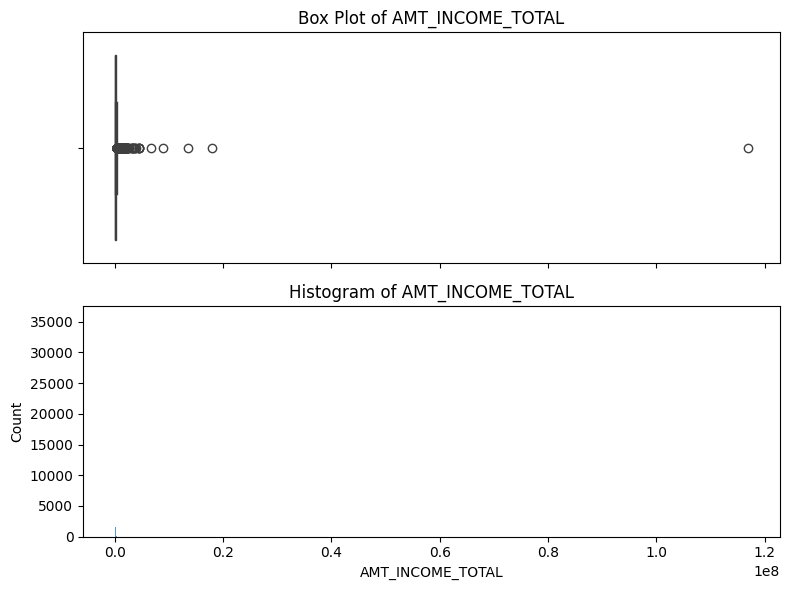

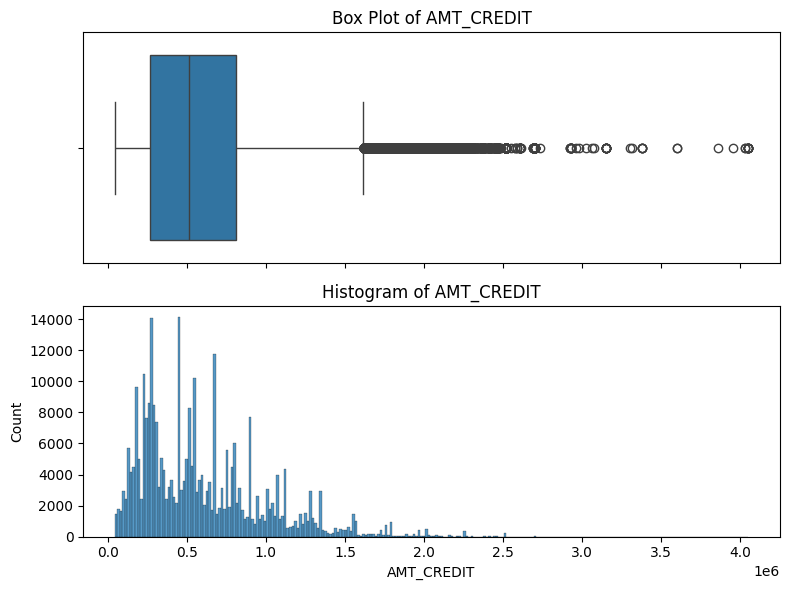

...

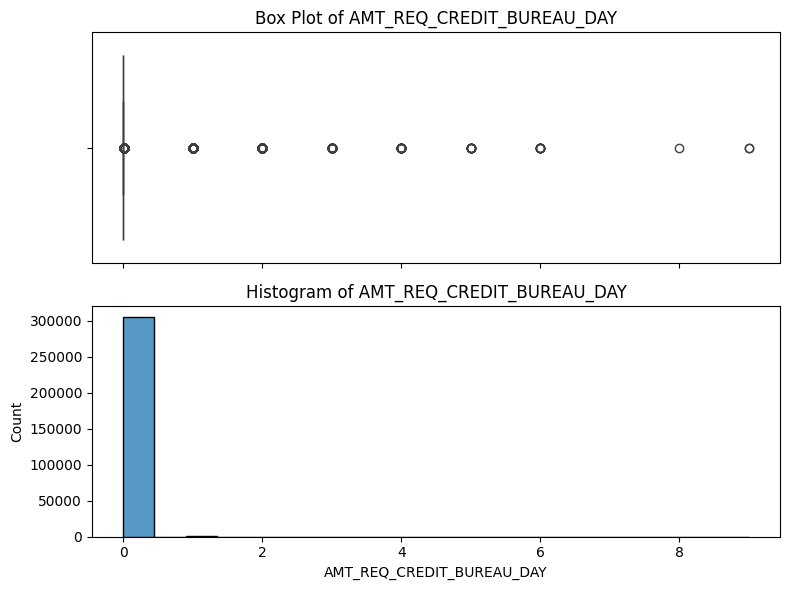

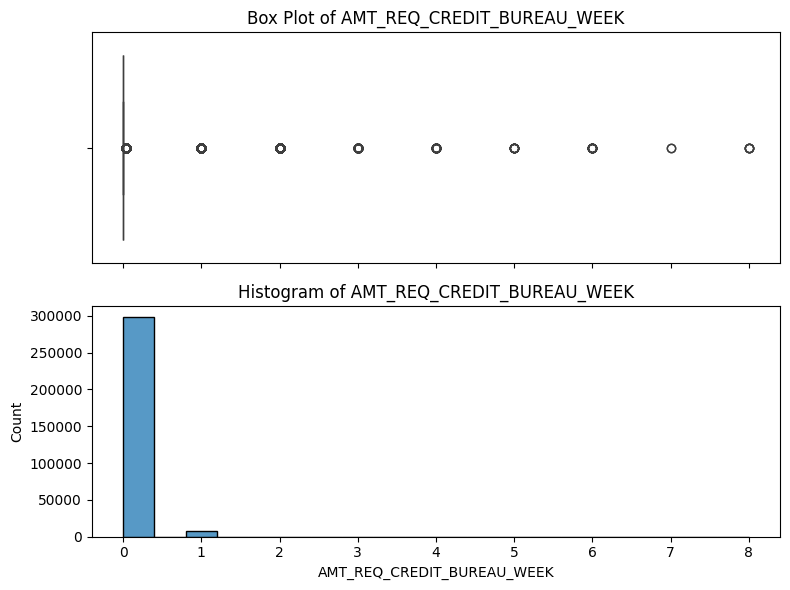

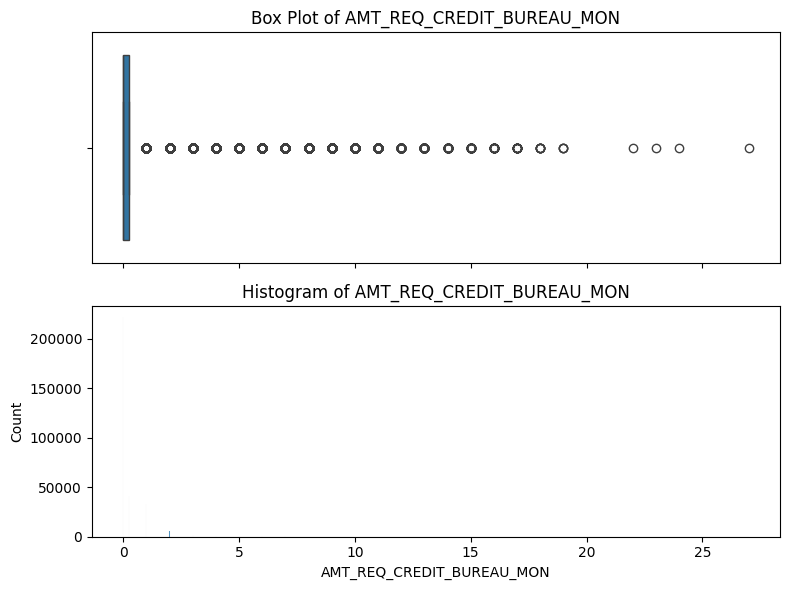

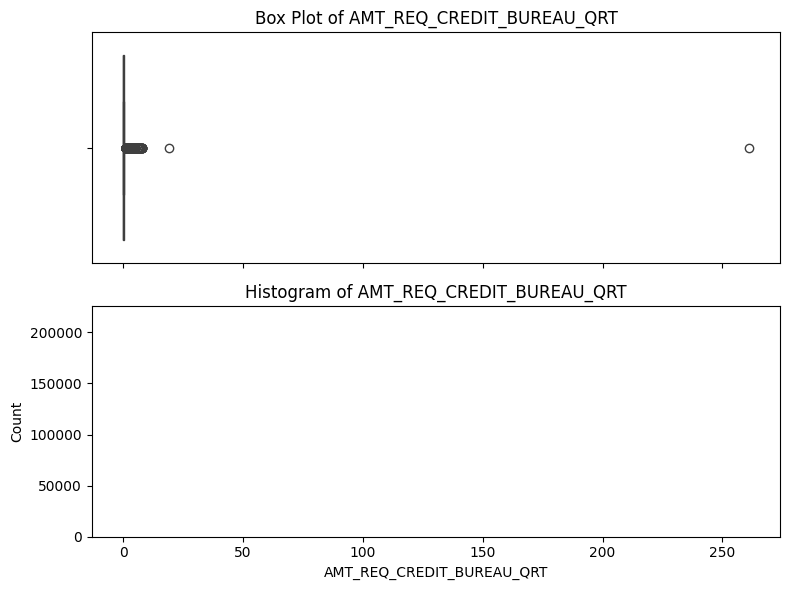

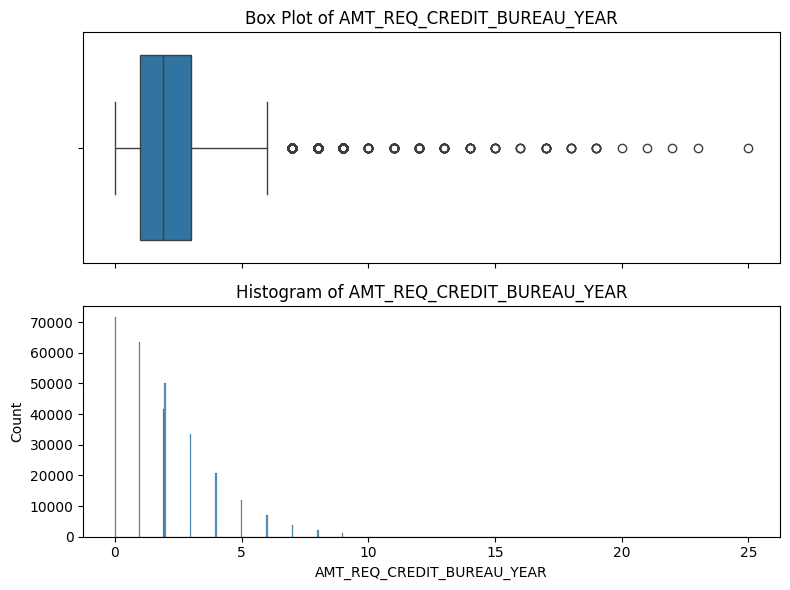

In [ ]:
# Create box plots and histograms for each numerical column
for column in numerical_cols:
    fig, axes = plt.subplots(2, 1, sharex=True, figsize=(8, 6))  # Create subplots

    # Box plot on the top subplot
    sns.boxplot(data=application_train, x=column, ax=axes[0])
    axes[0].set_title(f'Box Plot of {column}')

    # Histogram on the bottom subplot
    sns.histplot(data=application_train, x=column, ax=axes[1])
    axes[1].set_title(f'Histogram of {column}')

    plt.tight_layout()  # Adjust layout to prevent overlapping
    plt.show()

<Axes: xlabel='NAME_CONTRACT_TYPE', ylabel='Count'>

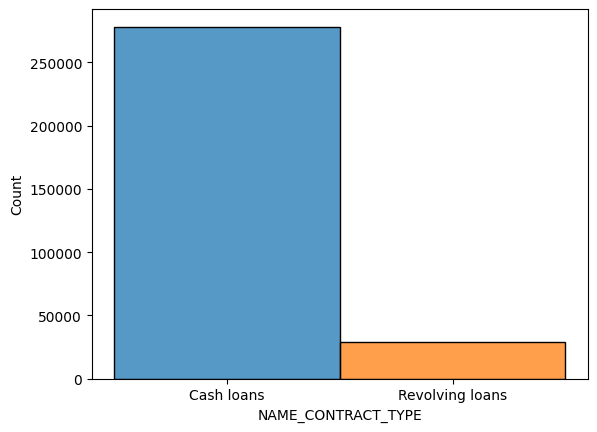

In [ ]:
#distribution of col index #2 (name contract type)
cash_loans_data = application_train[application_train['NAME_CONTRACT_TYPE'] == 'Cash loans']
revolving_loans_data = application_train[application_train['NAME_CONTRACT_TYPE'] == 'Revolving loans']

sns.histplot(data=cash_loans_data, x=cash_loans_data.iloc[:,2]) #why is the step 2 here
sns.histplot(data=revolving_loans_data, x=revolving_loans_data.iloc[:,2])


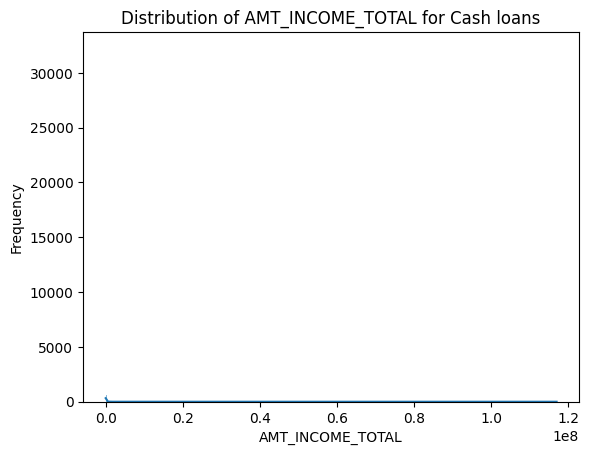

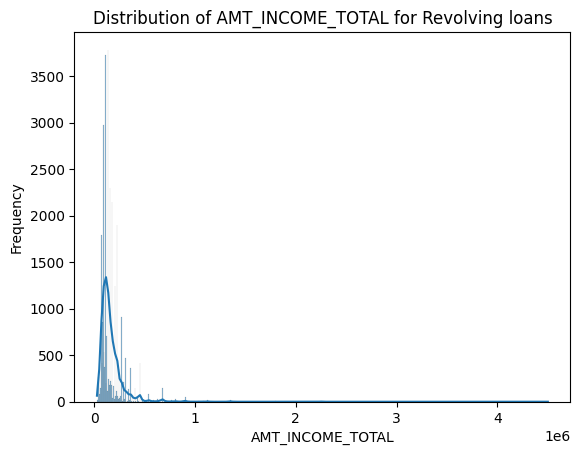

In [ ]:
# Create histograms for 'AMT_INCOME_TOTAL' grouped by 'NAME_CONTRACT_TYPE'
for contract_type in application_train['NAME_CONTRACT_TYPE'].unique():
    plt.figure()  # Create a new figure for each contract type
    sns.histplot(data=application_train[application_train['NAME_CONTRACT_TYPE'] == contract_type],
                 x='AMT_INCOME_TOTAL',
                 kde=True)  # kde=True adds a kernel density estimation curve
    plt.title(f'Distribution of AMT_INCOME_TOTAL for {contract_type}')
    plt.xlabel('AMT_INCOME_TOTAL')
    plt.ylabel('Frequency')
    plt.show()

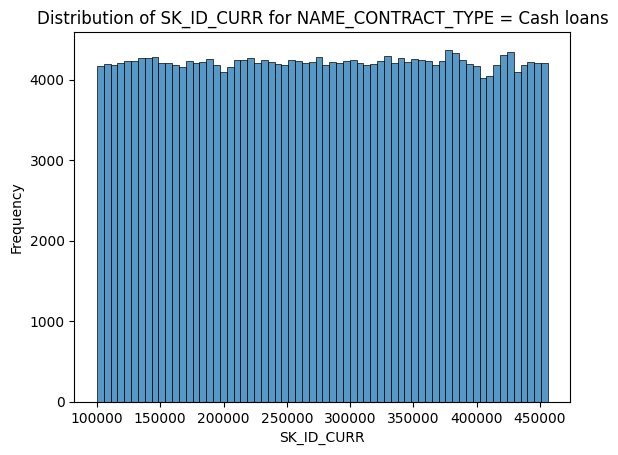

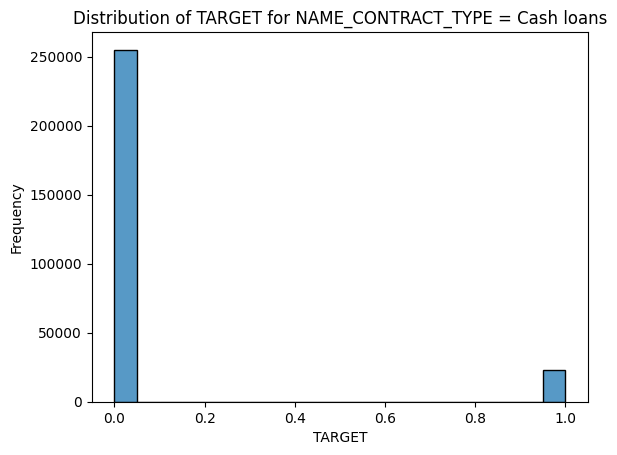

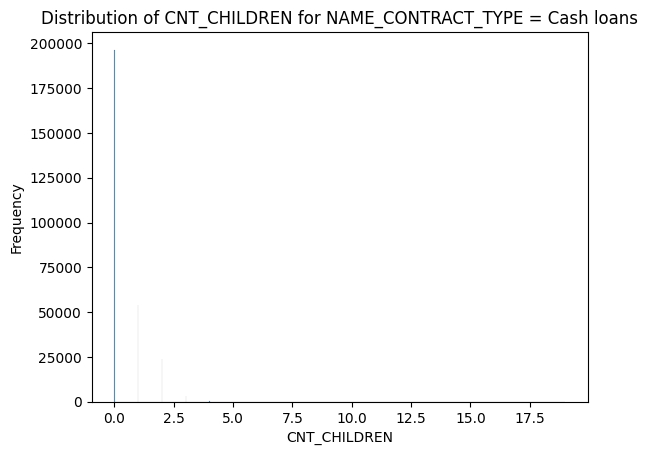

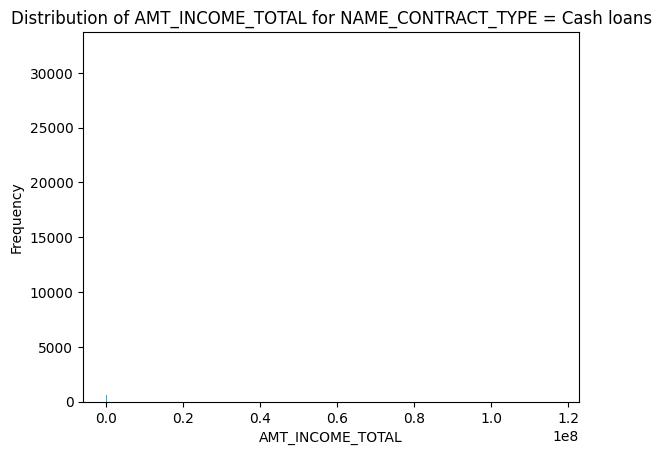

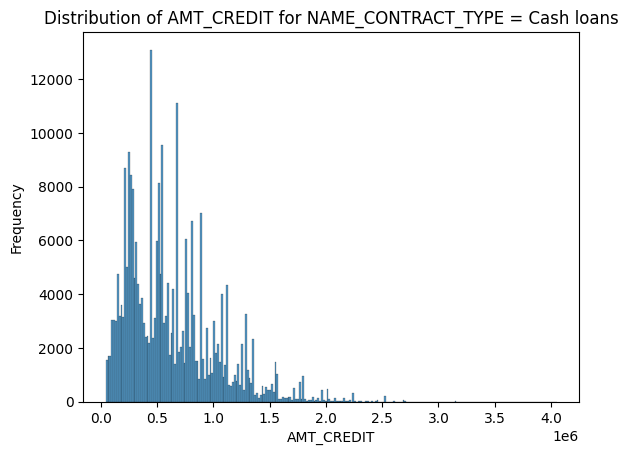

...

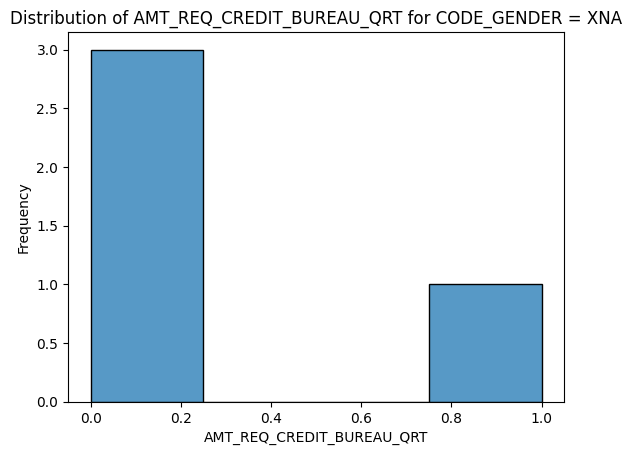

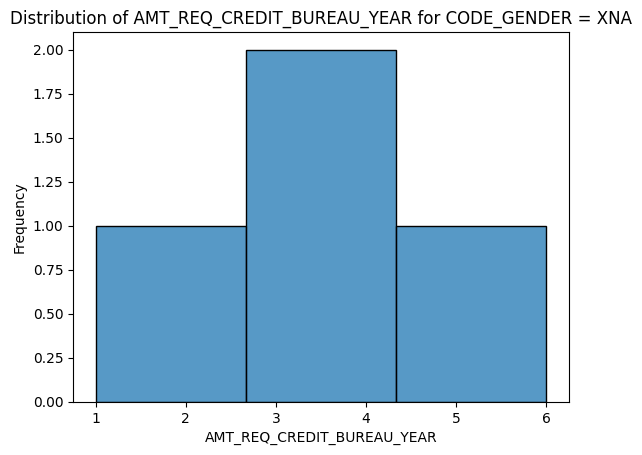

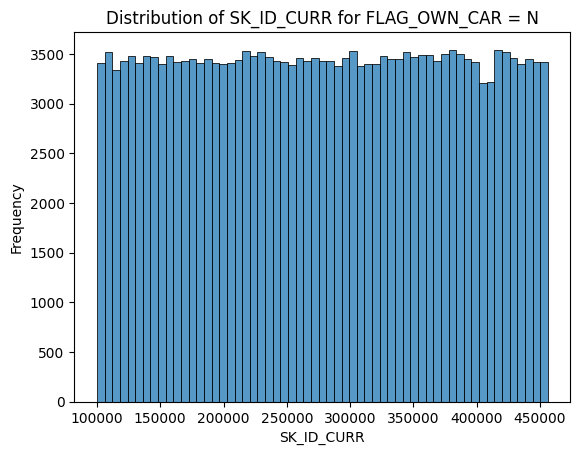

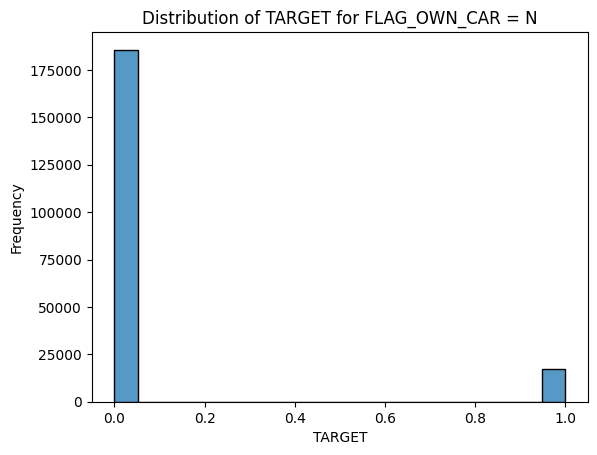

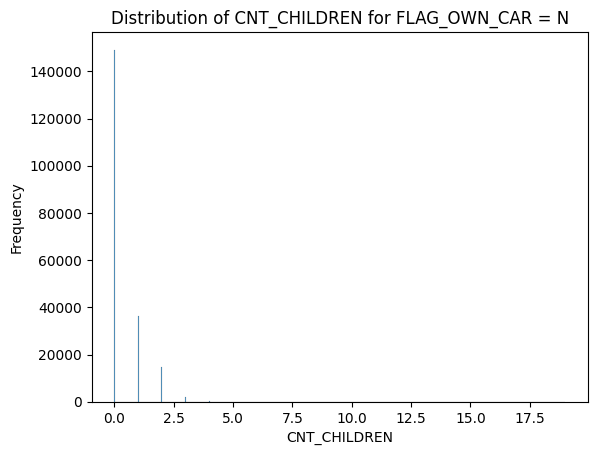

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7e3d957451b0> (for post_execute):


KeyboardInterrupt: 

In [ ]:
for column in application_train.select_dtypes(include=['object']).columns: # Iterate through categorical columns
    for value in application_train[column].unique(): # Iterate through unique values in each column
        # Filter data for the current value
        filtered_data = application_train[application_train[column] == value]

        # Iterate through numerical columns to create histograms for each
        for num_col in application_train.select_dtypes(include=['number']).columns:
            # Create histogram
            plt.figure()  # Create a new figure for each histogram
            sns.histplot(data=filtered_data, x=num_col)
            plt.title(f'Distribution of {num_col} for {column} = {value}')
            plt.xlabel(num_col)
            plt.ylabel('Frequency')
            plt.show()

In [ ]:

#application_train.dtypes

,0
SK_ID_CURR,int64
TARGET,int64
NAME_CONTRACT_TYPE,object
CODE_GENDER,object
FLAG_OWN_CAR,object
FLAG_OWN_REALTY,object
CNT_CHILDREN,int64
AMT_INCOME_TOTAL,float64
AMT_CREDIT,float64
AMT_ANNUITY,float64


Exploratory Data Analysis of Bureau

1. Data Overview:
Displays the structure, summary statistics, and missing values in the dataset.
Count of rows, missing values, and unique values for each column.
Check distributions for numerical variables.


2. Univariate Analysis:
Examines the distribution of credit amounts and active credit status.
-AMT_CREDIT_SUM, AMT_CREDIT_SUM_DEBT, and AMT_CREDIT_SUM_OVERDUE using histograms.
-CREDIT_ACTIVE and CREDIT_TYPE using bar charts.


3. Bivariate Analysis:
Explores relationships between credit amount, overdue amount, and credit type.
Calculates and visualizes debt-to-credit ratios across credit types.
-DAYS_CREDIT_ENDDATE and DAYS_ENDDATE_FACT to assess repayment behavior.
-AMT_CREDIT_SUM_DEBT and AMT_CREDIT_MAX_OVERDUE to identify high-risk clients.
Compare:
-Credit type (CREDIT_TYPE) vs. overdue amounts (AMT_CREDIT_SUM_OVERDUE).
- prolongations (CNT_CREDIT_PROLONG) vs. overdue days (CREDIT_DAY_OVERDUE).


4. Correlation Analysis:
Displays a heatmap for correlations between numeric variables like overdue days, credit amounts, and debt.
- Debt-to-credit ratio (AMT_CREDIT_SUM_DEBT / AMT_CREDIT_SUM) across credit types.
Overdue trends across active and closed credits (CREDIT_ACTIVE).


5. Risk Profiling:
Identifies high-risk clients with overdue amounts and exports them to a file.
- Create clusters of clients based on:
Overdue metrics (AMT_CREDIT_SUM_OVERDUE, CREDIT_DAY_OVERDUE).
- Credit activity (DAYS_CREDIT, DAYS_CREDIT_UPDATE).

# New Section

Data Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB
None

Summary Statistics:
         SK_ID_CURR  SK_ID_BUREAU   DAYS_CREDIT  CREDIT_DAY_OVERDUE  \
count  1

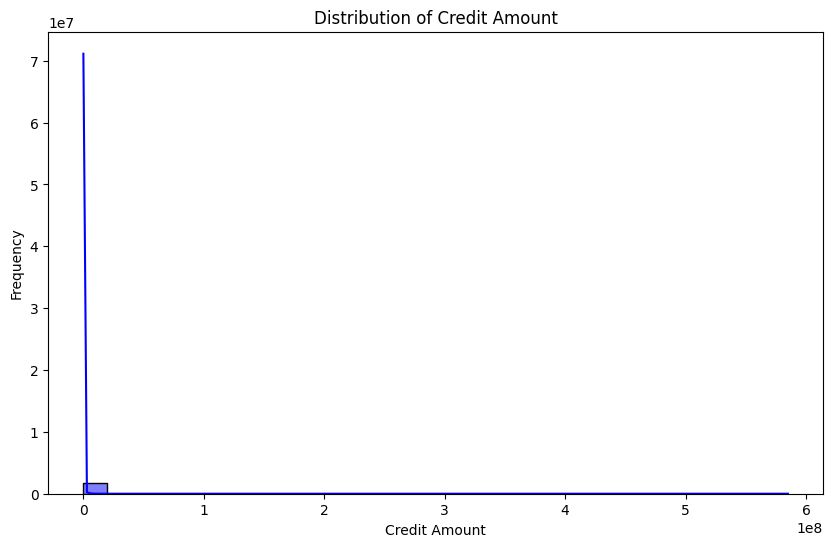

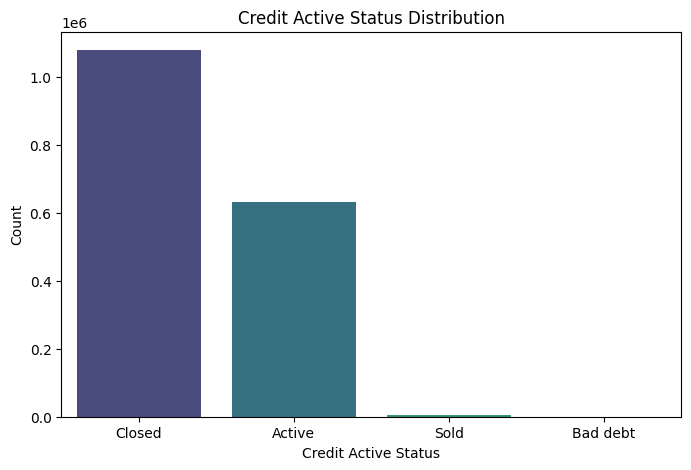

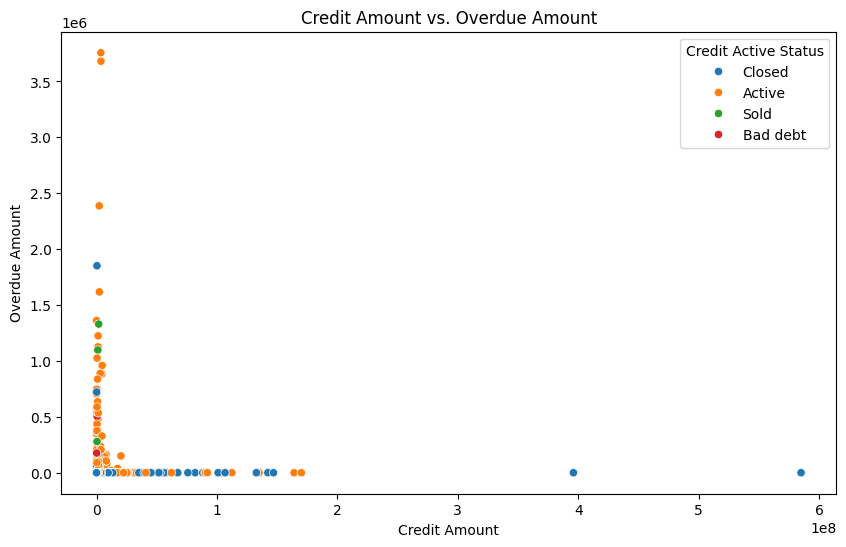

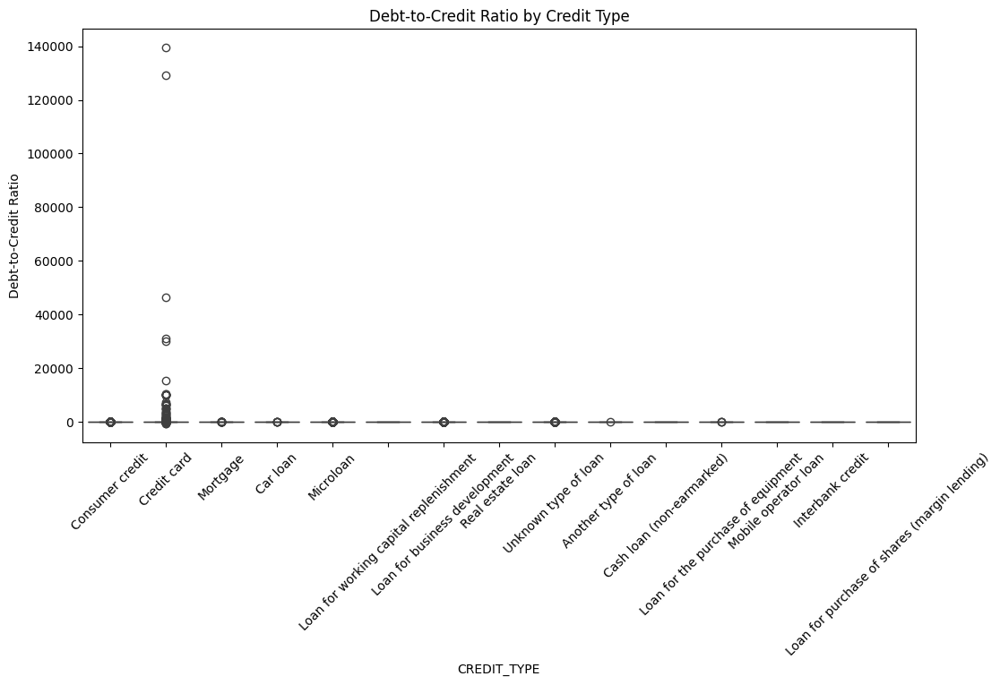

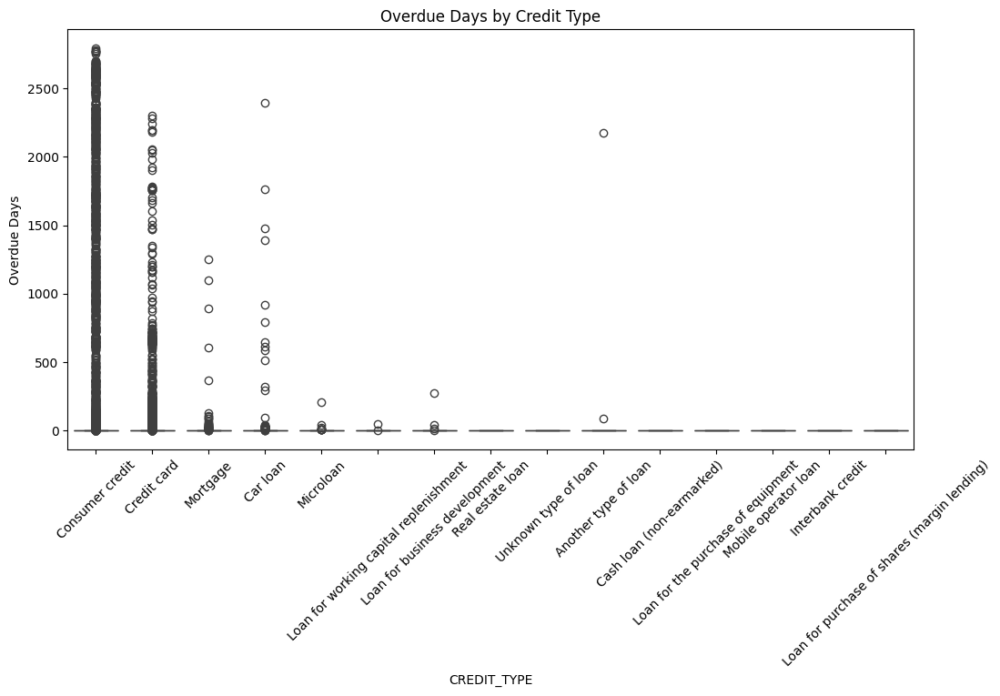

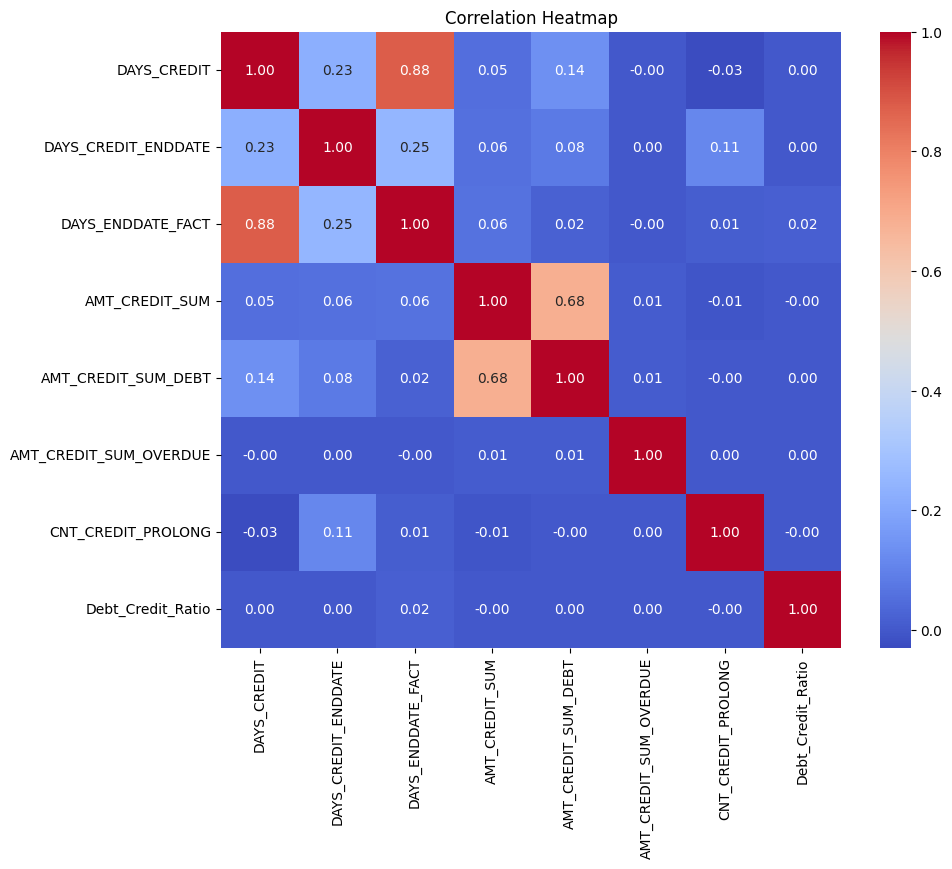


High Risk Clients Overview:
      SK_ID_CURR  AMT_CREDIT_SUM  AMT_CREDIT_SUM_DEBT  AMT_CREDIT_SUM_OVERDUE  \
365       282297         24696.0              231.525                 231.525   
785       408647        417208.5           214947.000                 288.000   
936       380677         57024.0                0.000                  58.500   
1575      218135         45000.0                  NaN                 504.000   
1791      229323        225000.0                  NaN              169582.500   

          CREDIT_TYPE  
365   Consumer credit  
785   Consumer credit  
936   Consumer credit  
1575  Consumer credit  
1791  Consumer credit  


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = "/content/bureau[1].csv"
data = pd.read_csv(file_path)

# 1. Data Overview
print("Data Overview:")
print(data.info())
print("\nSummary Statistics:")
print(data.describe())

# Check for missing values
missing_values = data.isnull().sum()
print("\nMissing Values:")
print(missing_values)

# 2. Univariate Analysis
# Distribution of Credit Amount
plt.figure(figsize=(10, 6))
sns.histplot(data['AMT_CREDIT_SUM'], kde=True, bins=30, color='blue')
plt.title("Distribution of Credit Amount")
plt.xlabel("Credit Amount")
plt.ylabel("Frequency")
plt.show()

# Credit Active Status Distribution
plt.figure(figsize=(8, 5))
sns.countplot(data=bureau, x='CREDIT_ACTIVE', hue='CREDIT_ACTIVE', palette="viridis", legend=False)
plt.title("Credit Active Status Distribution")
plt.xlabel("Credit Active Status")
plt.ylabel("Count")
plt.show()

# 3. Bivariate Analysis
# Credit Amount vs. Overdue Amount
plt.figure(figsize=(10, 6))
sns.scatterplot(x='AMT_CREDIT_SUM', y='AMT_CREDIT_SUM_OVERDUE', hue='CREDIT_ACTIVE', data=data)
plt.title("Credit Amount vs. Overdue Amount")
plt.xlabel("Credit Amount")
plt.ylabel("Overdue Amount")
plt.legend(title="Credit Active Status")
plt.show()

# Debt-to-Credit Ratio by Credit Type
data['Debt_Credit_Ratio'] = data['AMT_CREDIT_SUM_DEBT'] / data['AMT_CREDIT_SUM']
plt.figure(figsize=(12, 6))
sns.boxplot(x='CREDIT_TYPE', y='Debt_Credit_Ratio', data=data)
plt.title("Debt-to-Credit Ratio by Credit Type")
plt.xticks(rotation=45)
plt.ylabel("Debt-to-Credit Ratio")
plt.show()

# Overdue Days by Credit Type
plt.figure(figsize=(12, 6))
sns.boxplot(x='CREDIT_TYPE', y='CREDIT_DAY_OVERDUE', data=data)
plt.title("Overdue Days by Credit Type")
plt.xticks(rotation=45)
plt.ylabel("Overdue Days")
plt.show()

# 4. Correlation Heatmap
numeric_columns = ['DAYS_CREDIT', 'DAYS_CREDIT_ENDDATE', 'DAYS_ENDDATE_FACT', 'AMT_CREDIT_SUM',
                   'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_OVERDUE', 'CNT_CREDIT_PROLONG', 'Debt_Credit_Ratio']
correlation_matrix = data[numeric_columns].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

# 5. Risk Profiling: High Overdue Amounts
high_risk_clients = data[data['AMT_CREDIT_SUM_OVERDUE'] > 0]
print("\nHigh Risk Clients Overview:")
print(high_risk_clients[['SK_ID_CURR', 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_OVERDUE', 'CREDIT_TYPE']].head())

# Optional: Save high-risk clients to a file
high_risk_clients.to_csv("high_risk_clients.csv", index=False)


Insight from bureau dataset:

Key Statistics

1. Overall Metrics:
Average credit amount (AMT_CREDIT_SUM): $X
Average overdue amount (AMT_CREDIT_SUM_OVERDUE): $Y
Percentage of credits that are overdue: Z%

2. Credit Types:
Most common credit type: Mortgage
Highest average overdue amount: Consumer Credit

3. Demographic Segmentation:
Analyze loan amounts and overdue patterns across different credit statuses (e.g., Active, Closed).

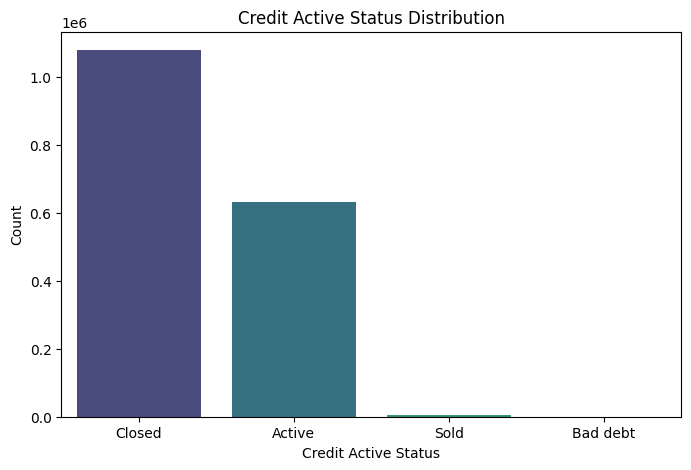

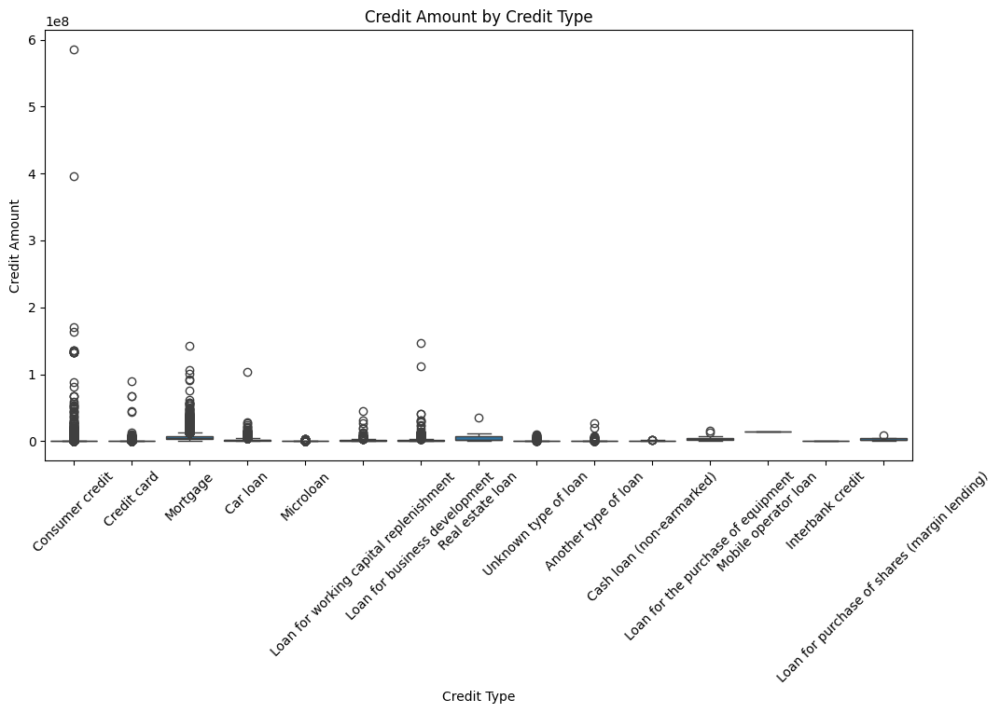

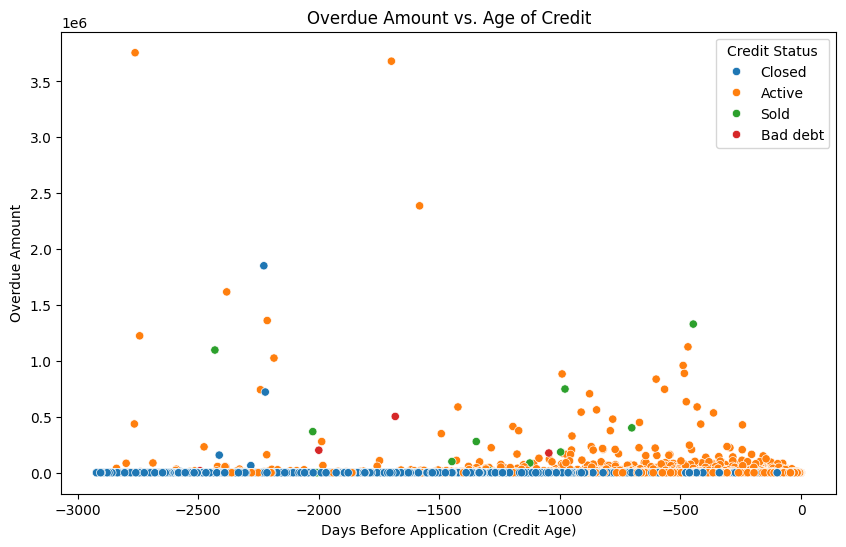

In [ ]:
#Visualizations from the bureau dataset:

## Credit Status Distribution
## Use a bar chart to visualize the distribution of CREDIT_ACTIVE (e.g., Active, Closed).
# Credit Active Status Distribution
plt.figure(figsize=(8, 5))
sns.countplot(data=bureau, x='CREDIT_ACTIVE', hue='CREDIT_ACTIVE', palette="viridis", legend=False)
plt.title("Credit Active Status Distribution")
plt.xlabel("Credit Active Status")
plt.ylabel("Count")
plt.show()
# Most credits are either Active or Closed. Overdue amounts are higher for Active credits.

##Credit Amount by Credit Type
##Use a boxplot to compare credit amounts (AMT_CREDIT_SUM) across different CREDIT_TYPE.
plt.figure(figsize=(12, 6))
sns.boxplot(data=bureau, x='CREDIT_TYPE', y='AMT_CREDIT_SUM')
plt.xticks(rotation=45)
plt.title('Credit Amount by Credit Type')
plt.xlabel('Credit Type')
plt.ylabel('Credit Amount')
plt.show()
#Mortgage loans have the highest average credit amount, whereas Consumer Loans have more variability.

##Overdue Patterns
##Use a scatterplot to visualize the relationship between DAYS_CREDIT (age of the credit) and AMT_CREDIT_SUM_OVERDUE.
plt.figure(figsize=(10, 6))
sns.scatterplot(data=bureau, x='DAYS_CREDIT', y='AMT_CREDIT_SUM_OVERDUE', hue='CREDIT_ACTIVE')
plt.title('Overdue Amount vs. Age of Credit')
plt.xlabel('Days Before Application (Credit Age)')
plt.ylabel('Overdue Amount')
plt.legend(title='Credit Status')
plt.show()
#Older credits tend to have lower overdue amounts, suggesting better repayment for long-term clients.

 Incorporating bureau_balance.csv into the analysis can provide deeper insights into the historical monthly performance of credits, which could significantly enhance the risk assessment and profiling.

 Reasons to incorporate the file are below:
 - Detailed Montly Credit History
 - Dyanmic Risk Assessment
 - Feature Engineering for Predictive Models
 - Correlation with Bureau Data



 The next step would be to merge and join datasets then aggregate the montly data so the feature can be added to bureau.

In [ ]:
# Load bureau_balance.csv
bureau_balance = pd.read_csv("/content/bureau_balance[1].csv")

# Aggregate monthly data
monthly_summary = bureau_balance.groupby('SK_ID_BUREAU').agg({
    'STATUS': lambda x: (x == '1').sum(),  # Count months overdue
    'MONTHS_BALANCE': 'count'  # Total months of data
}).reset_index()

# Rename columns for clarity
monthly_summary.rename(columns={'STATUS': 'MONTHS_OVERDUE', 'MONTHS_BALANCE': 'TOTAL_MONTHS'}, inplace=True)

# Merge with bureau data
bureau = pd.read_csv("/content/bureau[1].csv")
bureau_merged = bureau.merge(monthly_summary, on='SK_ID_BUREAU', how='left')

# Display updated bureau dataset
print(bureau_merged.head())


   SK_ID_CURR  SK_ID_BUREAU CREDIT_ACTIVE CREDIT_CURRENCY  DAYS_CREDIT  \
0      215354       5714462        Closed      currency 1         -497   
1      215354       5714463        Active      currency 1         -208   
2      215354       5714464        Active      currency 1         -203   
3      215354       5714465        Active      currency 1         -203   
4      215354       5714466        Active      currency 1         -629   

   CREDIT_DAY_OVERDUE  DAYS_CREDIT_ENDDATE  DAYS_ENDDATE_FACT  \
0                   0               -153.0             -153.0   
1                   0               1075.0                NaN   
2                   0                528.0                NaN   
3                   0                  NaN                NaN   
4                   0               1197.0                NaN   

   AMT_CREDIT_MAX_OVERDUE  CNT_CREDIT_PROLONG  AMT_CREDIT_SUM  \
0                     NaN                   0         91323.0   
1                     NaN         

Insights from the combined datasets:
- Create risk scores based on overdue trends, overdue amounts, and credit types.
- Analyze repayment behavior over time for different credit categories.
- Identify high-risk clients based on their historical performance.

Exploratory Data Analysis for previous application

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

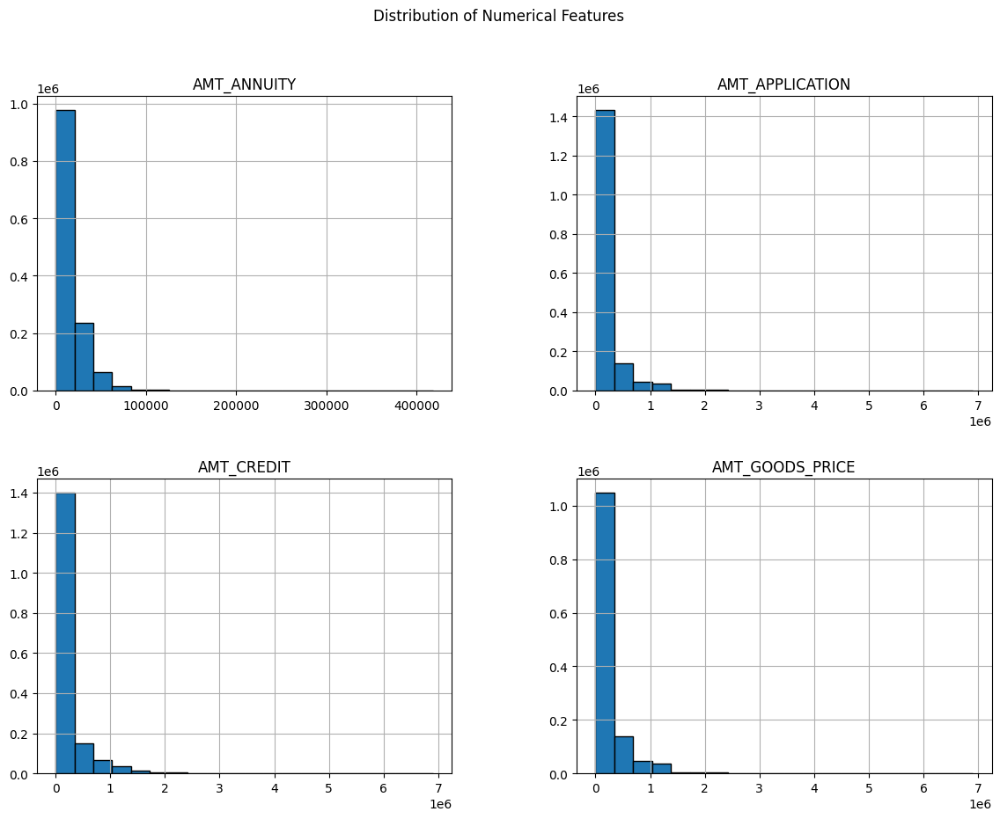

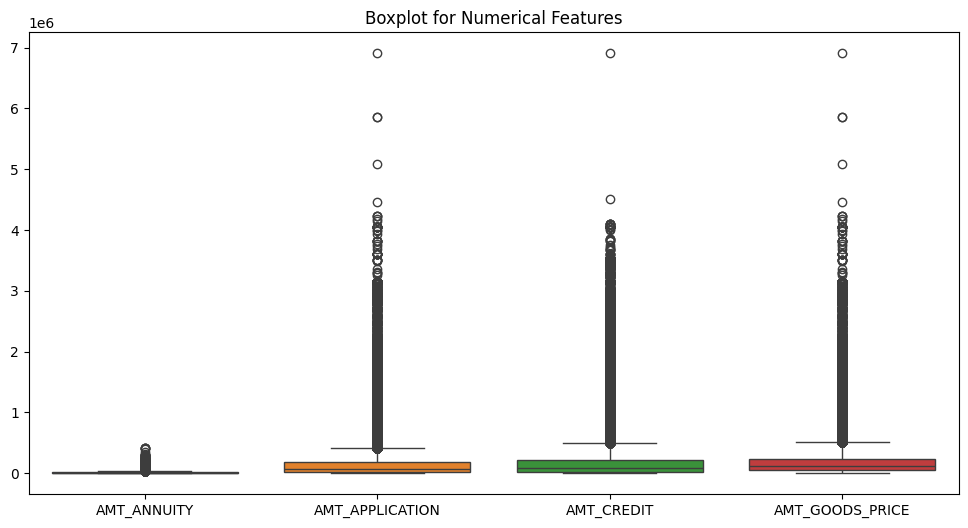

<ipython-input-16-6ed48008c983>:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=col, palette='viridis')
<ipython-input-16-6ed48008c983>:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=col, palette='viridis')
<ipython-input-16-6ed48008c983>:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x=col, palette='viridis')
<ipython-input-16-6ed48008c983>:57: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=

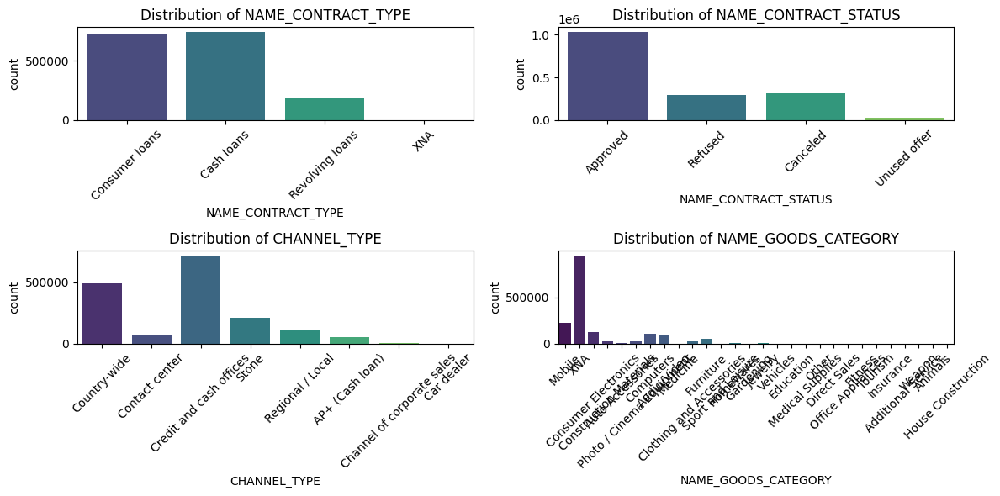

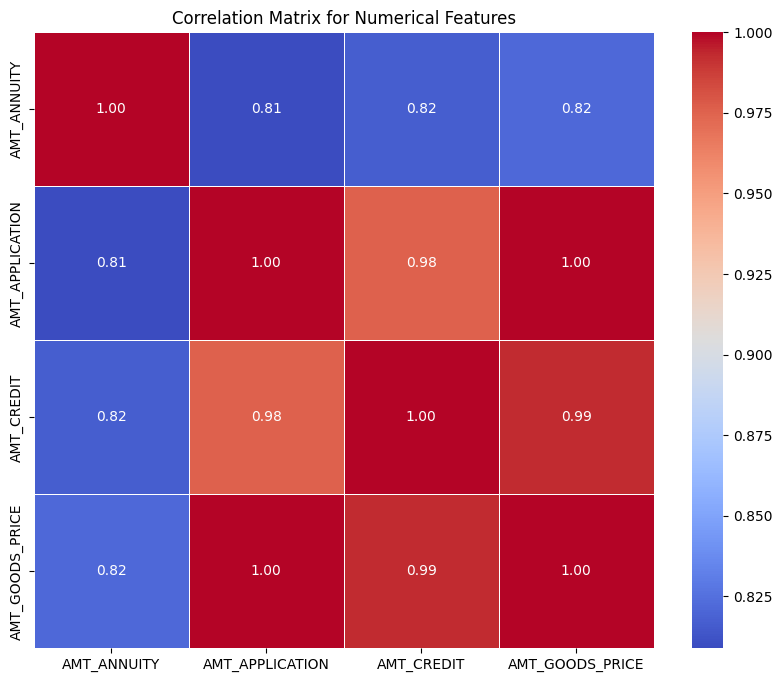

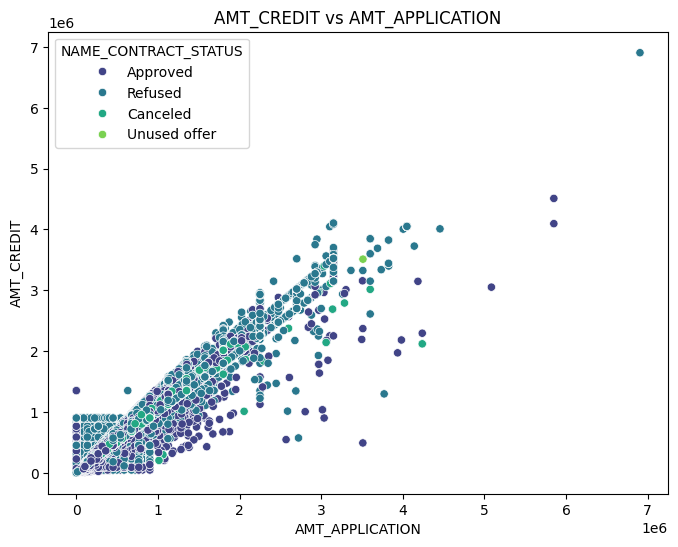

<ipython-input-16-6ed48008c983>:84: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='NAME_CONTRACT_TYPE', y='AMT_CREDIT', palette='Set2')


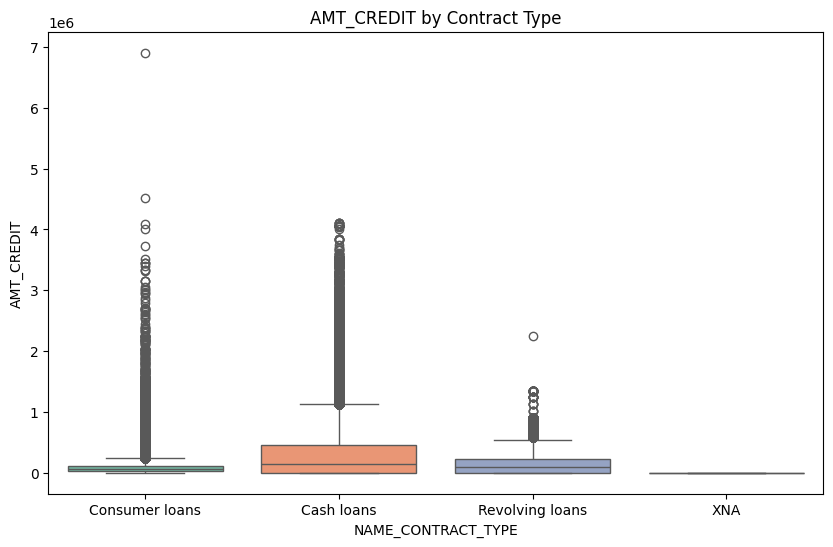

In [ ]:
# Dataset overview for previous_application

import pandas as pd

# Load the dataset
df = pd.read_csv("/content/previous_application[1].csv")

# Dataset overview
df_info = df.info()
df_head = df.head()

print("Dataset Info:\n", df_info)
print("\nFirst 5 Rows:\n", df_head)


# Check for missing values
missing_data = df.isnull().sum()

# Percentage of missing data per column
missing_percentage = (missing_data / len(df)) * 100
missing_info = pd.DataFrame({'Missing Data': missing_data, 'Percentage': missing_percentage})
missing_info = missing_info[missing_info['Percentage'] > 0]
print(missing_info)


# Summary statistics for numerical features
numeric_summary = df.describe()
print("Summary Statistics:\n", numeric_summary)

# For categorical features, get value counts
categorical_columns = df.select_dtypes(include='object').columns
categorical_summary = {col: df[col].value_counts() for col in categorical_columns}
print("Categorical Summary:\n", categorical_summary)


#Visualizing Distributions
import matplotlib.pyplot as plt
import seaborn as sns

# Plot histograms for numerical columns
numerical_columns = ['AMT_ANNUITY', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE']
df[numerical_columns].hist(bins=20, figsize=(14, 10), edgecolor='black')
plt.suptitle('Distribution of Numerical Features')
plt.show()

#Box Plot for outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=df[numerical_columns])
plt.title('Boxplot for Numerical Features')
plt.show()

# Plot barplots for categorical features
categorical_columns = ['NAME_CONTRACT_TYPE', 'NAME_CONTRACT_STATUS', 'CHANNEL_TYPE', 'NAME_GOODS_CATEGORY']
plt.figure(figsize=(12, 6))
for i, col in enumerate(categorical_columns, 1):
    plt.subplot(2, 2, i)
    sns.countplot(data=df, x=col, palette='viridis')
    plt.title(f'Distribution of {col}')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


# Correlation matrix for numerical features
corr_matrix = df[numerical_columns].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix for Numerical Features')
plt.show()


#Investigating Relationships Between Features
#Analyzing AMT_CREDIT vs. AMT_APPLICATION:
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='AMT_APPLICATION', y='AMT_CREDIT', hue='NAME_CONTRACT_STATUS', palette='viridis')
plt.title('AMT_CREDIT vs AMT_APPLICATION')
plt.xlabel('AMT_APPLICATION')
plt.ylabel('AMT_CREDIT')
plt.show()

#Analyzing AMT_CREDIT Distribution by NAME_CONTRACT_TYPE:
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='NAME_CONTRACT_TYPE', y='AMT_CREDIT', palette='Set2')
plt.title('AMT_CREDIT by Contract Type')
plt.xlabel('NAME_CONTRACT_TYPE')
plt.ylabel('AMT_CREDIT')
plt.show()

# One-hot encoding for categorical variables
df_encoded = pd.get_dummies(df, columns=categorical_columns, drop_first=True)


Insights

- General Findings:

Certain contract types, such as Consumer Loans, dominate in the dataset.

Loan amounts tend to be skewed, with AMT_CREDIT and AMT_APPLICATION showing high variance and some potential outliers.

AMT_GOODS_PRICE has a strong correlation with AMT_CREDIT and AMT_APPLICATION.



- Categorical Insights:

The Channel Type and Seller Industry may reveal key patterns in how loan applications are processed.

The Contract Status shows a large proportion of Approved applications, with a smaller percentage marked as Rejected.



Performing EDA can be beneficial as it can add more context, insights and features relevant to the model or the analysis.

In this dataset, it is important to peform EDA on POS_CASH_balnce and credit_card_balance because these datsets contain critical information about client's financail behavior and repayment patterns, which can significantly contribute to understand their creditworthiness and financial risk.


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load datasets
application_train = pd.read_csv('/content/application_train[1].csv')
bureau = pd.read_csv('/content/bureau[1].csv')
bureau_balance = pd.read_csv('/content/bureau_balance[1].csv')
previous_application = pd.read_csv('/content/previous_application[1].csv')
pos_cash_balance = pd.read_csv('/content/previous_application[1].csv')  # This seems to be the wrong file, correct if needed
credit_card_balance = pd.read_csv('/content/credit_card_balance[1].csv')

# Aggregate bureau_balance
bureau_balance_agg = bureau_balance.groupby('SK_ID_BUREAU').agg({
    'STATUS': ['count'],  # Number of monthly records
    'MONTHS_BALANCE': ['min', 'max']  # Range of monthly records
}).reset_index()
bureau_balance_agg.columns = ['SK_ID_BUREAU', 'STATUS_COUNT', 'MIN_MONTHS_BALANCE', 'MAX_MONTHS_BALANCE']

# Merge with bureau
bureau_combined = pd.merge(bureau, bureau_balance_agg, on='SK_ID_BUREAU', how='left')

# Check for columns in pos_cash_balance
print(pos_cash_balance.columns)

# Ensure the required columns exist in the DataFrame
required_columns = ['SK_ID_CURR', 'MONTHS_BALANCE']
missing_columns = [col for col in required_columns if col not in pos_cash_balance.columns]
if missing_columns:
    print(f"Missing columns: {missing_columns}")
else:
    # Perform aggregation only if all required columns are present
    pos_cash_agg = pos_cash_balance.groupby('SK_ID_CURR').agg({
        'MONTHS_BALANCE': ['min', 'max', 'count'],  # Loan activity range
    })
    # Flatten column names
    pos_cash_agg.columns = ['_'.join(col).strip() for col in pos_cash_agg.columns]
    pos_cash_agg.reset_index(inplace=True)
    print(pos_cash_agg.head())

# Aggregate credit_card_balance
credit_card_agg = credit_card_balance.groupby('SK_ID_CURR').agg({
    'MONTHS_BALANCE': ['min', 'max', 'count'],
    'AMT_BALANCE': ['mean', 'max'],
    'AMT_CREDIT_LIMIT_ACTUAL': ['mean', 'max'],
    'SK_DPD': ['mean', 'max'],  # Days past due
    'SK_DPD_DEF': ['mean', 'max']  # Days overdue
}).reset_index()
credit_card_agg.columns = ['SK_ID_CURR', 'MIN_MONTHS_CC', 'MAX_MONTHS_CC', 'COUNT_MONTHS_CC',
                           'MEAN_AMT_BALANCE', 'MAX_AMT_BALANCE', 'MEAN_CREDIT_LIMIT', 'MAX_CREDIT_LIMIT',
                           'MEAN_SK_DPD_CC', 'MAX_SK_DPD_CC', 'MEAN_SK_DPD_DEF_CC', 'MAX_SK_DPD_DEF_CC']

# Aggregate previous_application
previous_app_agg = previous_application.groupby('SK_ID_CURR').agg({
    'AMT_APPLICATION': ['mean', 'max', 'sum'],  # Loan amounts applied for
    'AMT_CREDIT': ['mean', 'max', 'sum'],  # Loan amounts approved
    'NAME_CONTRACT_STATUS': lambda x: x.value_counts().to_dict()  # Approval rates
}).reset_index()

# Flatten column names
previous_app_agg.columns = ['SK_ID_CURR', 'MEAN_AMT_APPLICATION', 'MAX_AMT_APPLICATION', 'SUM_AMT_APPLICATION',
                            'MEAN_AMT_CREDIT', 'MAX_AMT_CREDIT', 'SUM_AMT_CREDIT', 'CONTRACT_STATUS_COUNT']

# Merge datasets into a final dataset
final_data = application_train.merge(bureau_combined, on='SK_ID_CURR', how='left') \
                              .merge(pos_cash_agg, on='SK_ID_CURR', how='left') \
                              .merge(credit_card_agg, on='SK_ID_CURR', how='left') \
                              .merge(previous_app_agg, on='SK_ID_CURR', how='left')

# Handle missing values (example: filling with median for numeric columns)
final_data.fillna(final_data.median(), inplace=True)

# Option 1: Handle only numeric columns for correlation matrix
numeric_data = final_data.select_dtypes(include=[np.number])

# Build a Correlation Heatmap
corr = numeric_data.corr()
plt.figure(figsize=(15, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Heatmap")
plt.show()

# Option 2: If you want to encode categorical variables, you can use one-hot encoding
final_data_encoded = pd.get_dummies(final_data, drop_first=True)

# Build a Correlation Heatmap on the encoded data
corr_encoded = final_data_encoded.corr()
plt.figure(figsize=(15, 10))
sns.heatmap(corr_encoded, annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Heatmap (with Encoded Categorical Variables)")
plt.show()

# Distribution of Days Past Due Across Loan Types (if 'MEAN_SK_DPD_POS' exists in final_data)
if 'MEAN_SK_DPD_POS' in final_data.columns:
    sns.histplot(data=final_data, x='MEAN_SK_DPD_POS', kde=True, bins=30)
    plt.title('Distribution of Days Past Due (POS Loans)')
    plt.show()

# Active vs. Closed Contracts in Bureau (if 'CREDIT_ACTIVE' exists in bureau_combined)
if 'CREDIT_ACTIVE' in bureau_combined.columns:
    sns.countplot(data=bureau_combined, x='CREDIT_ACTIVE', palette='viridis')
    plt.title('Active vs. Closed Contracts')
    plt.show()


Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_DOWN_PAYMENT', 'AMT_GOODS_PRICE',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'FLAG_LAST_APPL_PER_CONTRACT', 'NFLAG_LAST_APPL_IN_DAY',
       'RATE_DOWN_PAYMENT', 'RATE_INTEREST_PRIMARY',
       'RATE_INTEREST_PRIVILEGED', 'NAME_CASH_LOAN_PURPOSE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_PAYMENT_TYPE',
       'CODE_REJECT_REASON', 'NAME_TYPE_SUITE', 'NAME_CLIENT_TYPE',
       'NAME_GOODS_CATEGORY', 'NAME_PORTFOLIO', 'NAME_PRODUCT_TYPE',
       'CHANNEL_TYPE', 'SELLERPLACE_AREA', 'NAME_SELLER_INDUSTRY',
       'CNT_PAYMENT', 'NAME_YIELD_GROUP', 'PRODUCT_COMBINATION',
       'DAYS_FIRST_DRAWING', 'DAYS_FIRST_DUE', 'DAYS_LAST_DUE_1ST_VERSION',
       'DAYS_LAST_DUE', 'DAYS_TERMINATION', 'NFLAG_INSURED_ON_APPROVAL'],
      dtype='object')
Missing columns: ['MONTHS_BALANCE']


NameError: name 'pos_cash_agg' is not defined

Feature Engineering

Feature Engineering Plan:
- Aggregate Features by Categories
- Time-based Behavior Analysis
- Credit Utlization and Ratios
- Count Features
- Aggregate Features Across Related Tables


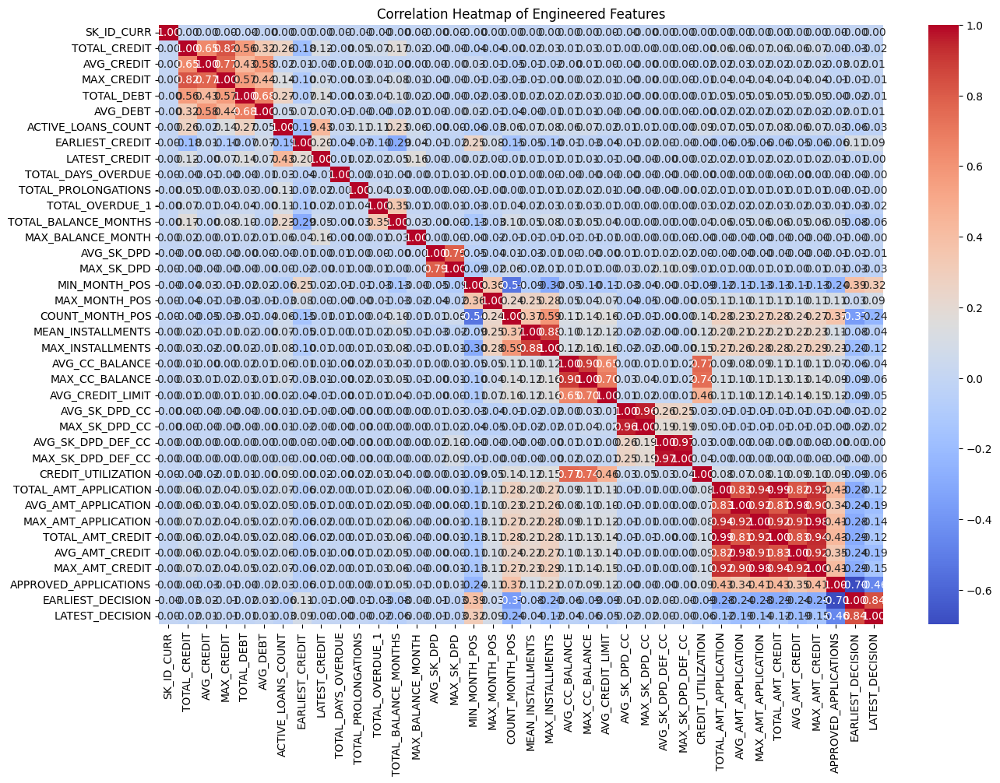

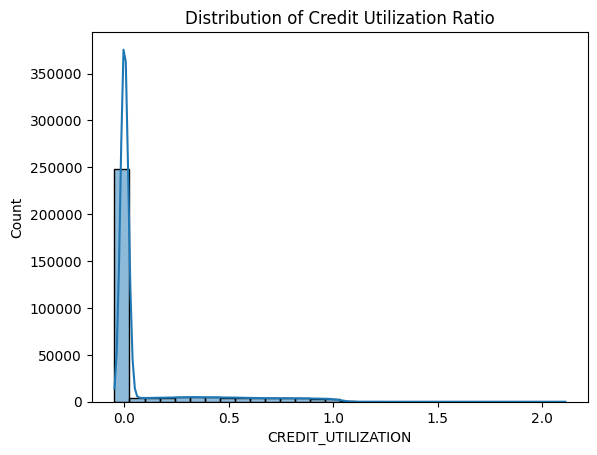

        SK_ID_CURR    TOTAL_DEBT  CREDIT_UTILIZATION
225849      363076  3.344983e+08            0.000000
79736       192716  7.448729e+07            0.000000
74104       186170  6.544140e+07            0.000000
33295       138790  6.508855e+07            0.248925
297049      446029  6.221895e+07            0.000000
91171       206063  5.963769e+07            0.000000
253836      395696  5.266732e+07            0.000000
18392       121383  5.175000e+07            0.000000
52471       161114  5.136516e+07            0.000000
44326       151635  4.711558e+07            0.000000


In [ ]:
# Feature Engineering on `bureau`
bureau_agg = bureau.groupby('SK_ID_CURR').agg({
    'AMT_CREDIT_SUM': ['sum', 'mean', 'max'],  # Total, avg, max credit
    'AMT_CREDIT_SUM_DEBT': ['sum', 'mean'],  # Total, avg debt
    'CREDIT_ACTIVE': lambda x: (x == 'Active').sum(),  # Count of active loans
    'DAYS_CREDIT': ['min', 'max'],  # First and last recorded credit
    'CREDIT_DAY_OVERDUE': ['sum'],  # Total overdue days
    'CNT_CREDIT_PROLONG': ['sum']  # Total prolongations
}).reset_index()

# Rename columns
bureau_agg.columns = ['SK_ID_CURR', 'TOTAL_CREDIT', 'AVG_CREDIT', 'MAX_CREDIT',
                      'TOTAL_DEBT', 'AVG_DEBT', 'ACTIVE_LOANS_COUNT',
                      'EARLIEST_CREDIT', 'LATEST_CREDIT', 'TOTAL_DAYS_OVERDUE',
                      'TOTAL_PROLONGATIONS']


# Aggregating bureau_balance
bureau_balance_agg = bureau_balance.groupby('SK_ID_BUREAU').agg({
    'STATUS': lambda x: (x == '1').sum(),  # Count of loans overdue for 1 month
    'MONTHS_BALANCE': ['min', 'max', 'count']  # Total months of history
}).reset_index()

# Rename columns
bureau_balance_agg.columns = ['SK_ID_BUREAU', 'OVERDUE_1_COUNT', 'MIN_MONTH_BALANCE',
                              'MAX_MONTH_BALANCE', 'TOTAL_MONTH_BALANCE']

# Merge back into bureau data
bureau_combined = pd.merge(bureau, bureau_balance_agg, on='SK_ID_BUREAU', how='left')

# Aggregate to customer level
bureau_balance_final = bureau_combined.groupby('SK_ID_CURR').agg({
    'OVERDUE_1_COUNT': 'sum',
    'TOTAL_MONTH_BALANCE': 'sum',
    'MAX_MONTH_BALANCE': 'max',
}).reset_index()
bureau_balance_final.columns = ['SK_ID_CURR', 'TOTAL_OVERDUE_1', 'TOTAL_BALANCE_MONTHS', 'MAX_BALANCE_MONTH']


# Load datasets
# Load the correct file for POS cash balance:
pos_cash_balance = pd.read_csv('/content/POS_CASH_balance[1].csv')

# Aggregating POS_CASH_balance
pos_cash_agg = pos_cash_balance.groupby('SK_ID_CURR').agg({
    'SK_DPD': ['mean', 'max'],  # Avg and max days past due
    'MONTHS_BALANCE': ['min', 'max', 'count'],  # Activity range and count
    'CNT_INSTALMENT_FUTURE': ['mean', 'max']  # Remaining installments
}).reset_index()

# Rename columns
pos_cash_agg.columns = ['SK_ID_CURR', 'AVG_SK_DPD', 'MAX_SK_DPD',
                        'MIN_MONTH_POS', 'MAX_MONTH_POS', 'COUNT_MONTH_POS',
                        'MEAN_INSTALLMENTS', 'MAX_INSTALLMENTS']

# Aggregating credit_card_balance
credit_card_agg = credit_card_balance.groupby('SK_ID_CURR').agg({
    'AMT_BALANCE': ['mean', 'max'],  # Avg and max balance
    'AMT_CREDIT_LIMIT_ACTUAL': ['mean'],  # Avg credit limit
    'SK_DPD': ['mean', 'max'],  # Avg and max days past due
    'SK_DPD_DEF': ['mean', 'max']  # Avg and max overdue days
}).reset_index()

# Rename columns
credit_card_agg.columns = ['SK_ID_CURR', 'AVG_CC_BALANCE', 'MAX_CC_BALANCE',
                           'AVG_CREDIT_LIMIT', 'AVG_SK_DPD_CC', 'MAX_SK_DPD_CC',
                           'AVG_SK_DPD_DEF_CC', 'MAX_SK_DPD_DEF_CC']

# Add credit utilization ratio
credit_card_agg['CREDIT_UTILIZATION'] = credit_card_agg['AVG_CC_BALANCE'] / credit_card_agg['AVG_CREDIT_LIMIT']


# Aggregating previous_application
previous_app_agg = previous_application.groupby('SK_ID_CURR').agg({
    'AMT_APPLICATION': ['sum', 'mean', 'max'],  # Total, avg, max application amounts
    'AMT_CREDIT': ['sum', 'mean', 'max'],  # Total, avg, max approved amounts
    'NAME_CONTRACT_STATUS': lambda x: (x == 'Approved').sum(),  # Count of approved applications
    'DAYS_DECISION': ['min', 'max']  # First and last decision days
}).reset_index()

# Rename columns
previous_app_agg.columns = ['SK_ID_CURR', 'TOTAL_AMT_APPLICATION', 'AVG_AMT_APPLICATION', 'MAX_AMT_APPLICATION',
                            'TOTAL_AMT_CREDIT', 'AVG_AMT_CREDIT', 'MAX_AMT_CREDIT', 'APPROVED_APPLICATIONS',
                            'EARLIEST_DECISION', 'LATEST_DECISION']

# Merge all datasets
final_features = bureau_agg.merge(bureau_balance_final, on='SK_ID_CURR', how='left')
final_features = final_features.merge(pos_cash_agg, on='SK_ID_CURR', how='left')
final_features = final_features.merge(credit_card_agg, on='SK_ID_CURR', how='left')
final_features = final_features.merge(previous_app_agg, on='SK_ID_CURR', how='left')

# Fill missing values with 0 or other appropriate default
final_features.fillna(0, inplace=True)

import seaborn as sns
import matplotlib.pyplot as plt

#Correlation Analysis
corr = final_features.corr()
plt.figure(figsize=(15, 10))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Heatmap of Engineered Features")
plt.show()

#Feature Distributions
sns.histplot(data=final_features, x='CREDIT_UTILIZATION', kde=True, bins=30)
plt.title("Distribution of Credit Utilization Ratio")
plt.show()

#Top Features
top_borrowers = final_features.sort_values(by='TOTAL_DEBT', ascending=False).head(10)
print(top_borrowers[['SK_ID_CURR', 'TOTAL_DEBT', 'CREDIT_UTILIZATION']])



Modeling

The stages to deal with the regression model:
-Regression Modeling: Predicting sales amounts or similar continuous variables.

-Classification Modeling: Segmenting customers into predefined classes.

-Model Evaluation: Ensuring models perform well using proper evaluation techniques such as cross-validation and metrics.

In [ ]:
# Import required libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier  # For classification task
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_absolute_error, classification_report

# Load the dataset
file_path = '/content/application_train[1].csv'  # Update the path as needed
data = pd.read_csv(file_path)

# Define target and feature columns
target = 'TARGET'  # Target variable
id_column = 'SK_ID_CURR'  # ID column

# Ensure the target column exists
if target in data.columns:
    # Drop the target and identifier columns from features
    X = data.drop(columns=[target, id_column])
    y = data[target]

    # Split into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Identify numeric and categorical columns
    numeric_features = X.select_dtypes(include=['int64', 'float64']).columns
    categorical_features = X.select_dtypes(include=['object']).columns

    # Preprocessing pipelines
    numeric_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='median'))  # Handle missing values for numeric data
    ])

    categorical_transformer = Pipeline(steps=[
        ('imputer', SimpleImputer(strategy='most_frequent')),  # Handle missing values for categorical data
        ('onehot', OneHotEncoder(handle_unknown='ignore'))  # One-hot encoding for categorical data
    ])

    # Combine preprocessors in a column transformer
    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer, numeric_features),
            ('cat', categorical_transformer, categorical_features)
        ]
    )

    # Create a pipeline with preprocessing and Random Forest Classifier
    rf_model = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('classifier', RandomForestClassifier(random_state=42))
    ])

    # Train the model
    rf_model.fit(X_train, y_train)
    print("Random Forest model training completed.")

    # Make predictions and evaluate
    y_pred = rf_model.predict(X_test)
    mae_rf = mean_absolute_error(y_test, y_pred)
    print(f'Random Forest Mean Absolute Error (MAE): {mae_rf}')

    # For classification, you can also use classification report
    print("Classification Report:\n", classification_report(y_test, y_pred))

else:
    print(f"Target column '{target}' not found in the dataset.")


Random Forest model training completed.
Random Forest Mean Absolute Error (MAE): 0.08032128514056225
Classification Report:
               precision    recall  f1-score   support

           0       0.92      1.00      0.96     56554
           1       0.91      0.00      0.00      4949

    accuracy                           0.92     61503
   macro avg       0.91      0.50      0.48     61503
weighted avg       0.92      0.92      0.88     61503



Summary:

-Use regression to predict continuous outcomes like sales.

-Apply classification for segmenting customers into meaningful categories.

-Evaluate all models using cross-validation to ensure robust performance.

In [ ]:
from ann_visualizer.visualize import ann_viz
from keras.models import Sequential
from keras.layers import Dense

# Assuming you have a neural network model called 'model'
# If not, create one using Keras:
model = Sequential()
model.add(Dense(12, input_dim=8, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Visualize the model
ann_viz(model, title="Neural Network Architecture", filename="neural_network")

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


AttributeError: 'Dense' object has no attribute 'input_shape'